In [ ]:
videolink= 'https://github.com/gkioxari/aims2020_visualrecognition/releases/download/v1.0/videoclip.zip'
directory= './clip/' #path for the video frames

In [ ]:
!wget $videolink -q -O clip.zip

In [ ]:
!unzip clip.zip >/dev/null

In [ ]:
import os
import cv2
from google.colab.patches import cv2_imshow
from scipy.optimize import linear_sum_assignment 

In [ ]:
# install detectron2: (Colab has CUDA 11.1 + torch 1.10)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
import torch
assert torch.__version__.startswith("1.10")   # need to manually install torch 1.10 if Colab changes its default version
!python -m pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.10/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.10/index.html
     |████████████████████████████████| 7.0 MB 1.0 MB/s 
     |████████████████████████████████| 74 kB 2.2 MB/s 
     |████████████████████████████████| 50 kB 5.6 MB/s 
     |████████████████████████████████| 145 kB 11.2 MB/s 
     |████████████████████████████████| 130 kB 43.0 MB/s 
     |████████████████████████████████| 749 kB 44.7 MB/s 
     |████████████████████████████████| 843 kB 37.7 MB/s 
     |████████████████████████████████| 596 kB 44.5 MB/s 
     |████████████████████████████████| 112 kB 45.2 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20220305-py3-none-any.whl size=61214 sha256=ef74d1ccf52368a293fda28c91f383db8021f12b27390d3eedf65b5aca1cd518
  Stored in directory: /root/.cache/pip/wheels/b5/b7/6e/43b1693d06fac3633af48db68557513b0a37ab38b0a8b798f9
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.8-py3-none-any.whl size=141230 sha256=934

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [ ]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
cfg.MODEL.ROI_HEADS.NMS_THRESH_TEST = 0.5
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)

model_final_280758.pkl: 167MB [00:03, 52.0MB/s]                           


In [ ]:
colors= ['b','g','r', 'c','m','y','brown', 'purple', 'indigo','silver', 'pink','gold', 'salmon', 'darkorange', 'lime', 'darkcyan', 'violet', 'deeppink','orchid','teal', 'sienna']

##Part A: Detecting Objects in Frames

In [ ]:
frames= os.listdir(directory)
frames.sort()
framelength= len(frames)

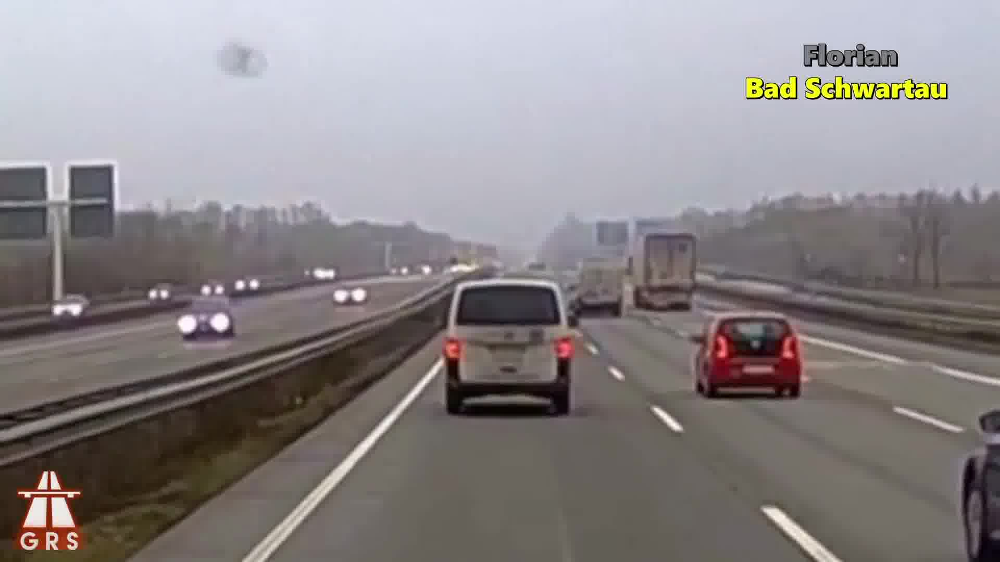

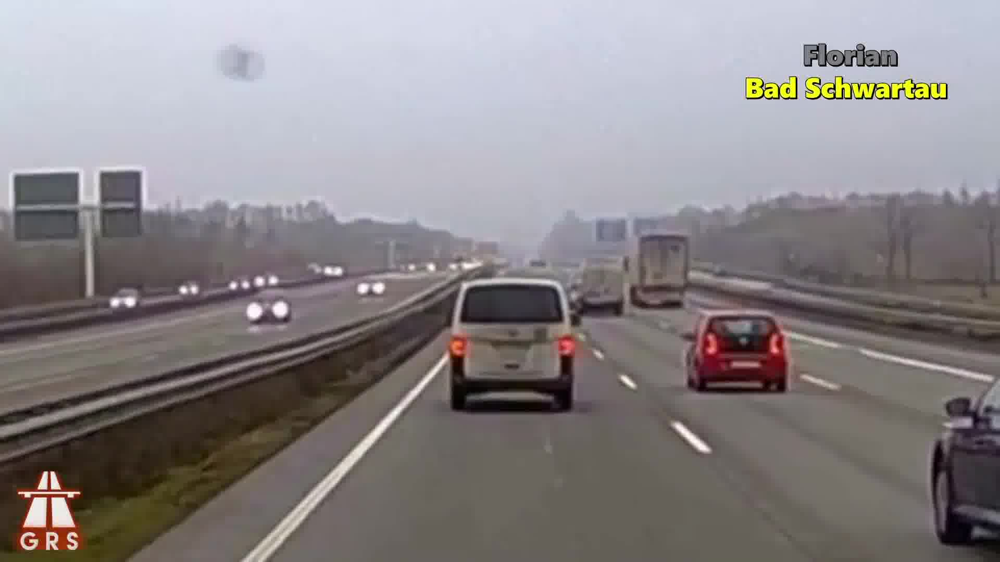

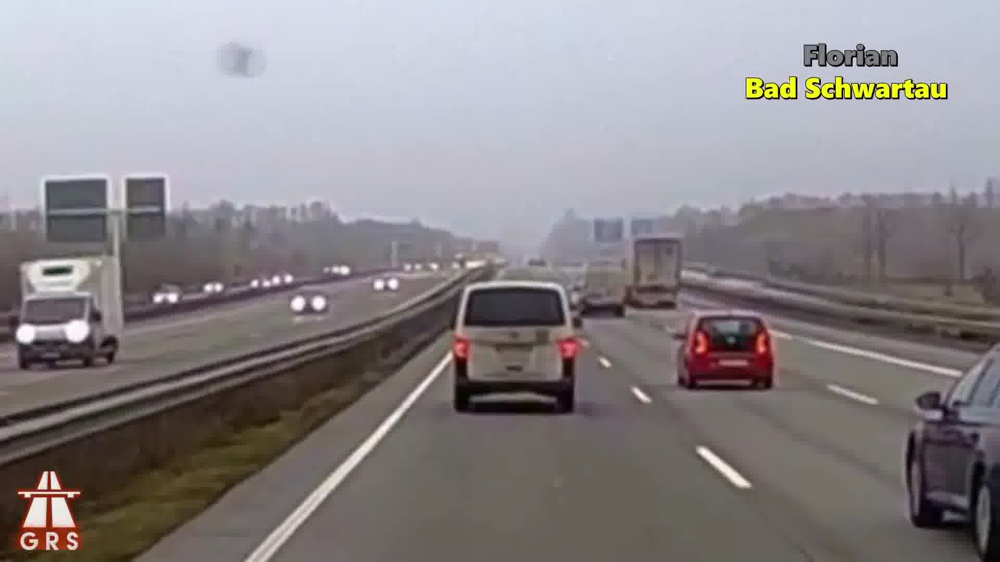

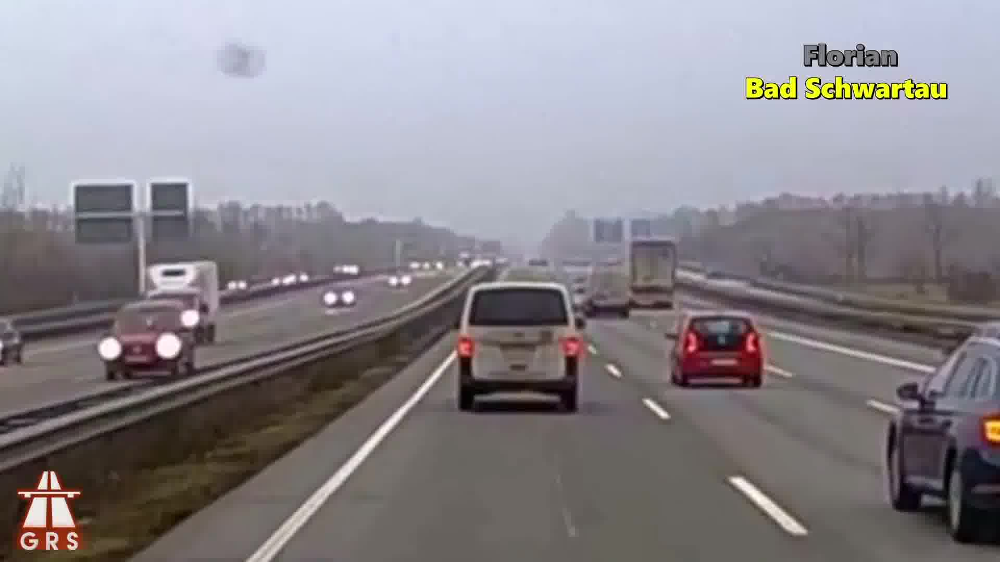

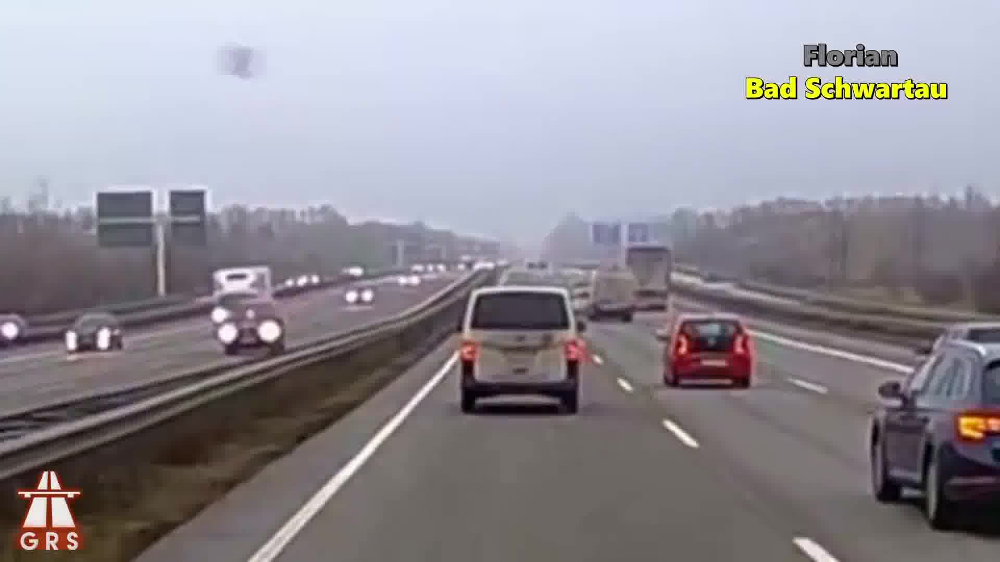

In [ ]:
number = 5
#Dispaly frames of the video
assert number<framelength, 'number of frames to be displayed should be less than the length of frames'
for i in reversed(range(number)):
  im = cv2.imread(directory+frames[i])
  cv2_imshow(im)

In [ ]:
#Store predictions for all frames in the video
predictions=[]
for i in range(framelength):
  im = cv2.imread(directory+frames[i])
  outputs= predictor(im)
  predictions.append(outputs['instances'])

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


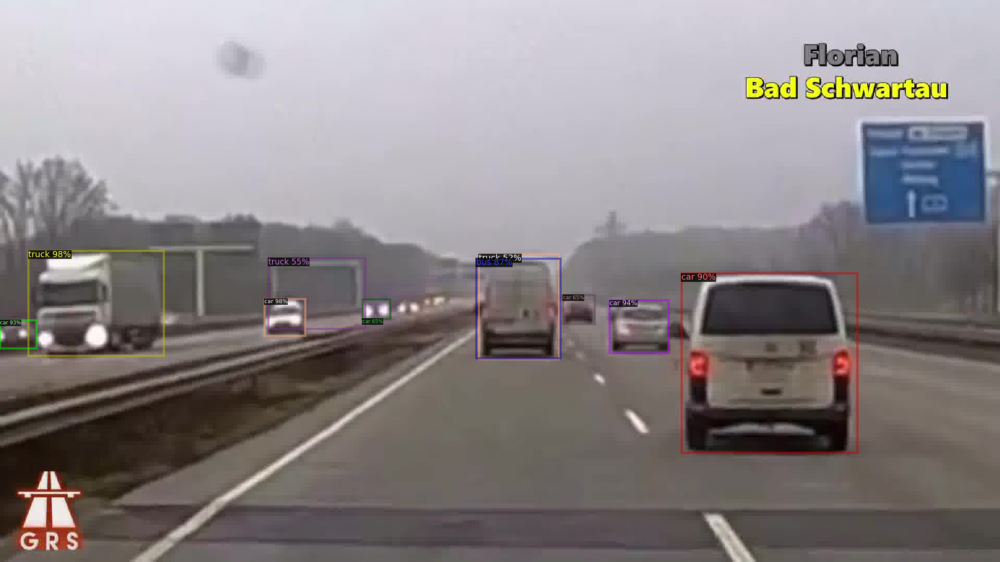

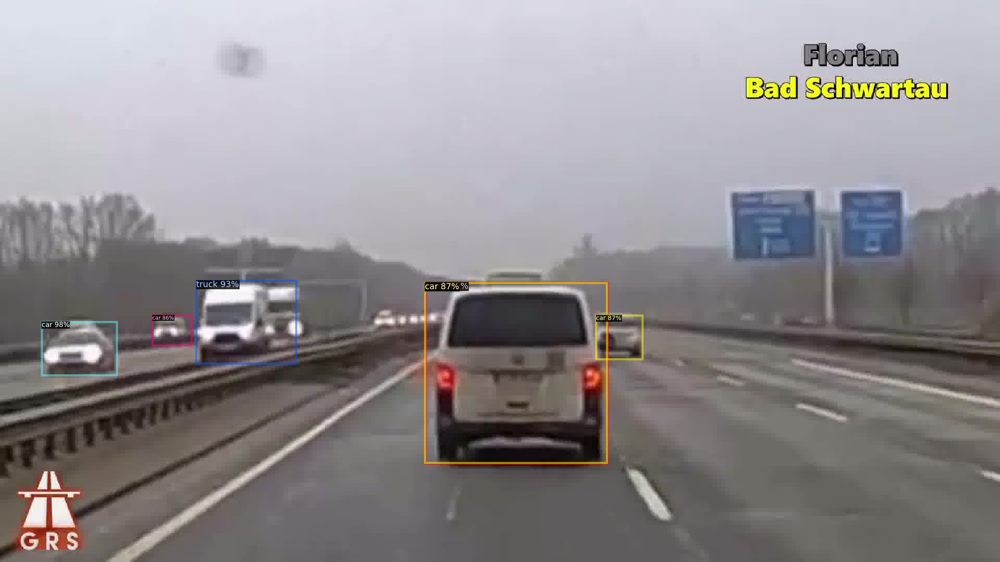

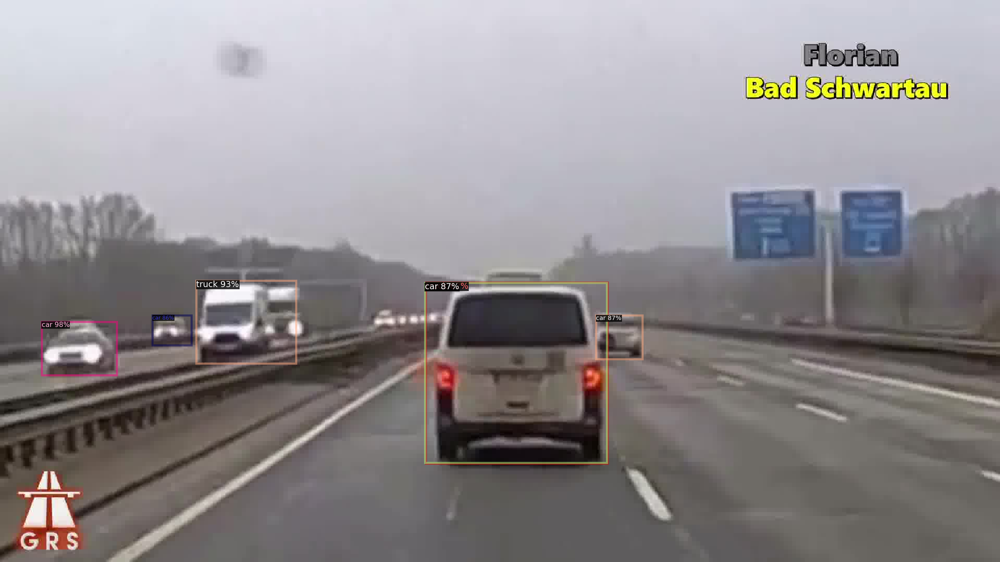

In [ ]:
#Visualize some random frames prediction
sample =3
assert sample<framelength, 'sample should be less than the length of frames'
for i in torch.randint(0,framelength,(3,)):
  im = cv2.imread(directory+frames[i])
  v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
  out = v.draw_instance_predictions(predictions[i].to("cpu"))
  img=out.get_image()[:, :, ::-1]
  cv2_imshow(img)

##Part B: Tracking Objects in a pairs of Frames

In [ ]:
def calculate_iou(boxA, boxB):
    # determine the (x, y)-coordinates of the intersection rectangle
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    # compute the area of intersection rectangle
    interArea = abs(max((xB - xA, 0)) * max((yB - yA), 0))
    if interArea == 0:
        return 0
    # compute the area of both the prediction and ground-truth
    # rectangles
    boxAArea = abs((boxA[2] - boxA[0]) * (boxA[3] - boxA[1]))
    boxBArea = abs((boxB[2] - boxB[0]) * (boxB[3] - boxB[1]))

    # compute the intersection over union by taking the intersection
    # area and dividing it by the sum of prediction + ground-truth
    # areas - the interesection area
    iou = interArea / float(boxAArea + boxBArea - interArea)

    # return the intersection over union value
    return iou

In [ ]:
def match_score(index, frame1, frame2, with_iou, assignment):
  #retruns index of the matching object in frame1 for the object in frame2 with index 'index' 
  #Uses the linear sum assignment algorithm to get the best match
  im1 = cv2.imread(directory+frames[frame1])
  im2 = cv2.imread(directory+frames[frame2])
  outputs1 = predictor(im1)
  outputs2 = predictor(im2)
  pred1=predictions[frame1].pred_classes
  pred2=predictions[frame2].pred_classes
  boxes1=predictions[frame1].pred_boxes.tensor.cpu().numpy()
  boxes2=predictions[frame2].pred_boxes.tensor.cpu().numpy()
  m= torch.zeros((len(pred1),len(pred2)))
  #Creating the matching score
  for i in range(len(pred1)):
    for j in range(len(pred2)):
        if with_iou:
          iou=calculate_iou(list(boxes1[i]), list(boxes2[j]))
        else:
          iou=1
        m[i,j] = (pred1[i]==pred2[j])*iou
  if assignment:
    if(m.shape[0]<m.shape[1]):
      dummy_row= np.zeros((m.shape[1]-m.shape[0], m.shape[1]))
      mnew= np.concatenate((m, dummy_row), axis=0)
      assignment= linear_sum_assignment(mnew.T, maximize=True)[1]
      row_indx= linear_sum_assignment(mnew.T, maximize=True)[0]
      if mnew.T[row_indx[index], assignment[index]]==0.0:
        return None
      assignment=[t if t<m.shape[0] else None for t in assignment ]
    else:
      assignment= linear_sum_assignment(m.T, maximize=True)[1]
      row_indx= linear_sum_assignment(m.T, maximize=True)[0]
      if m.T[row_indx[index], assignment[index]]==0.0:
        return None
    matched_index= assignment[index]
  else:
    for i in range(len(pred1)):
      for j in range(len(pred2)):
          if with_iou:
            iou=calculate_iou(list(boxes1[i]), list(boxes2[j]))
          else:
            iou=1
          m[i,j] = (pred1[i]==pred2[j])*iou
    max_match= m.max(0)
    max_value = max_match.values[index]
    if max_value!=0.0:
      matched_index= int(max_match.indices[index])
    else:
      return None
  return matched_index


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


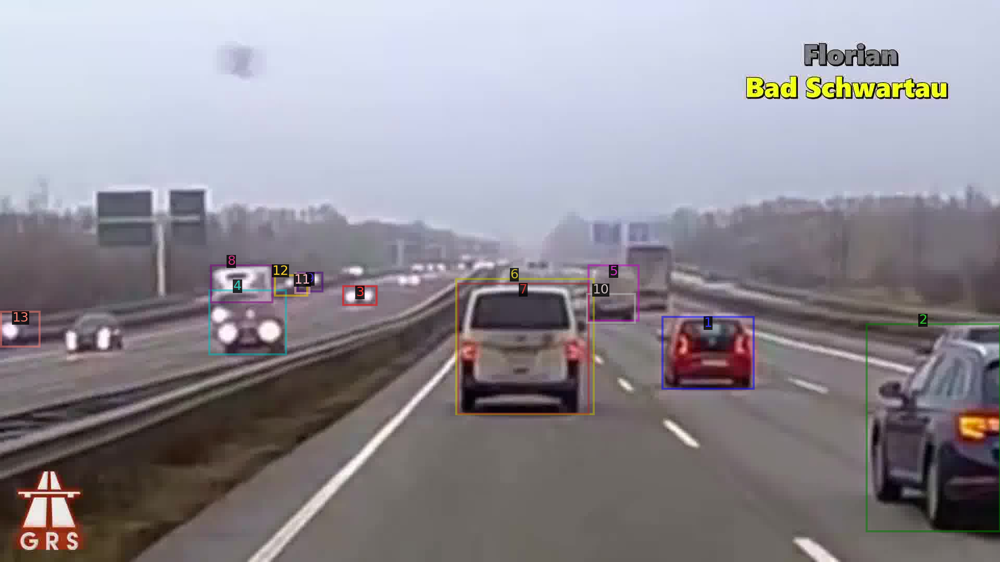

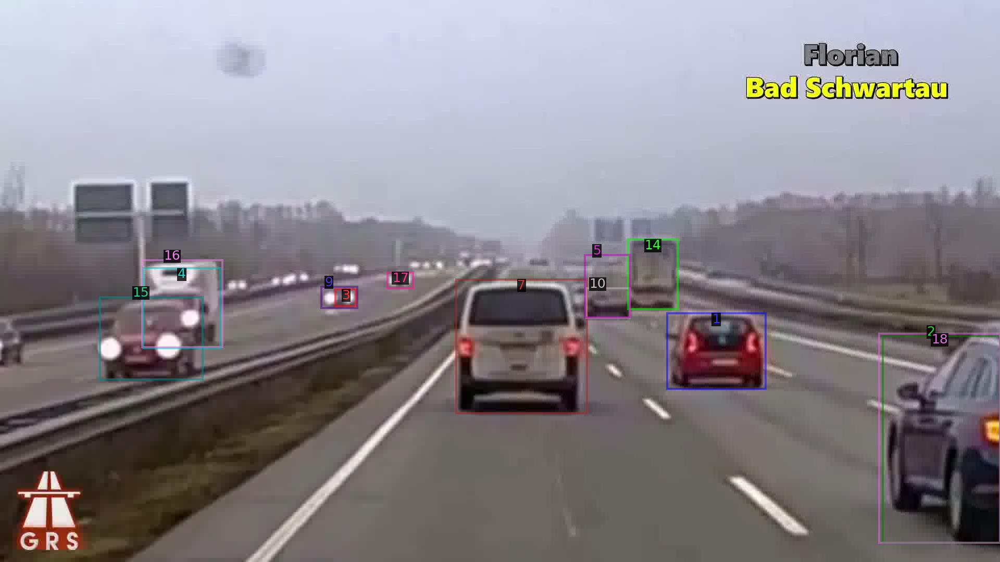

In [ ]:
frame1, frame2= 0, 1 # change the pair of indices here
with_iou=True # Change it here if you don't want to use iou in matching score, if False it will use category based linking
assignment_maching_score=True # To Use linear sum assignment for caluculating the best match else argmax will be used

assert frame1<len(predictions) and frame2<len(predictions), 'the frames index should be less than the available'
assert frame2-frame1==1, 'frames should be consecutive'
im1 = cv2.imread(directory+frames[frame1])
im2 = cv2.imread(directory+frames[frame2])
v1= Visualizer(im1[:, :, ::-1])
v2= Visualizer(im2[:, :, ::-1])
object_count1=len(predictions[frame1])
object_count2=len(predictions[frame2])
id= object_count1
boxes1 = predictions[frame1].pred_boxes.tensor.cpu().numpy()
boxes2 = predictions[frame2].pred_boxes.tensor.cpu().numpy()

for i in range(object_count1):
  box_coordinate1=boxes1[i]
  offset=(i*20)%40
  out1= v1.draw_box(box_coordinate1, alpha=0.5, edge_color=colors[i%20], line_style='-')
  out1=v1.draw_text(str(i+1), (((box_coordinate1[0]+box_coordinate1[2])/2)-offset,box_coordinate1[1]-offset),font_size=25, color=colors[i%20])
for j in range(object_count2):
  matched_index = match_score(j, frame1, frame2,with_iou, assignment_maching_score)
  offset =(j*20)%40
  if matched_index!=None:
    box_coordinate2=boxes2[j]
    out2= v2.draw_box(box_coordinate2, alpha=0.5, edge_color=colors[matched_index%20], line_style='-')
    out2=v2.draw_text(str(matched_index+1), (((box_coordinate2[0]+box_coordinate2[2])/2)-offset,box_coordinate2[1]-offset),font_size=25, color=colors[matched_index%20])
  else:
    #If match doesn't found register it as a new object
    box_coordinate2=boxes2[j]
    out2= v2.draw_box(box_coordinate2, alpha=0.5, edge_color=colors[(id+1)%20], line_style='-')
    out2=v2.draw_text(str(id+1), (((box_coordinate2[0]+box_coordinate2[2])/2)-offset,box_coordinate2[1]-offset),font_size=25, color=colors[(id+1)%20])
    id+=1
img1=out1.get_image()[:, :, ::-1]
img2=out2.get_image()[:, :, ::-1]
# cv2.imwrite('./report/ttpair39.jpg', img1)
# cv2.imwrite('./report/ttpair40.jpg', img2)
cv2_imshow(img1)
cv2_imshow(img2)

#Part C: Tracking Objects in a video

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


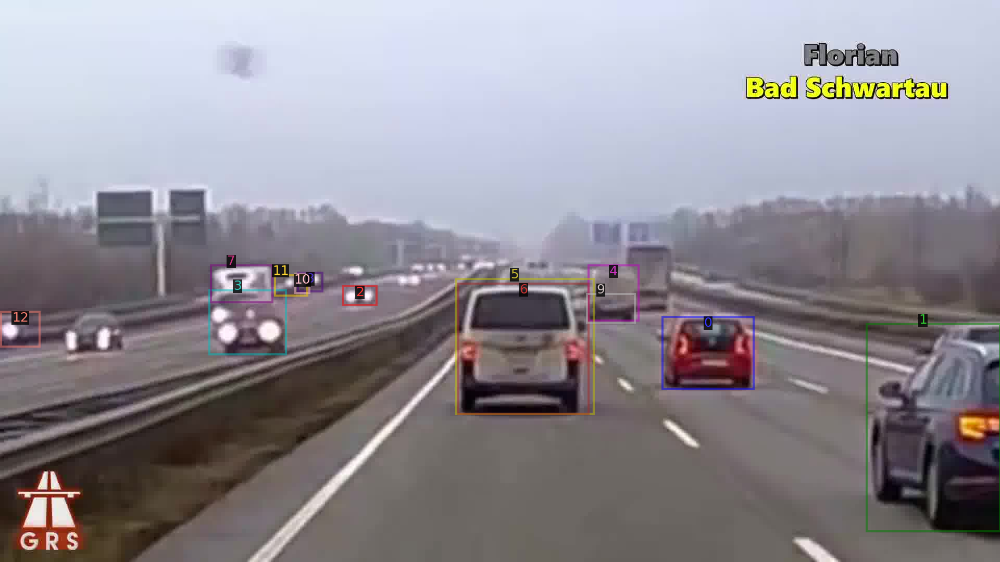

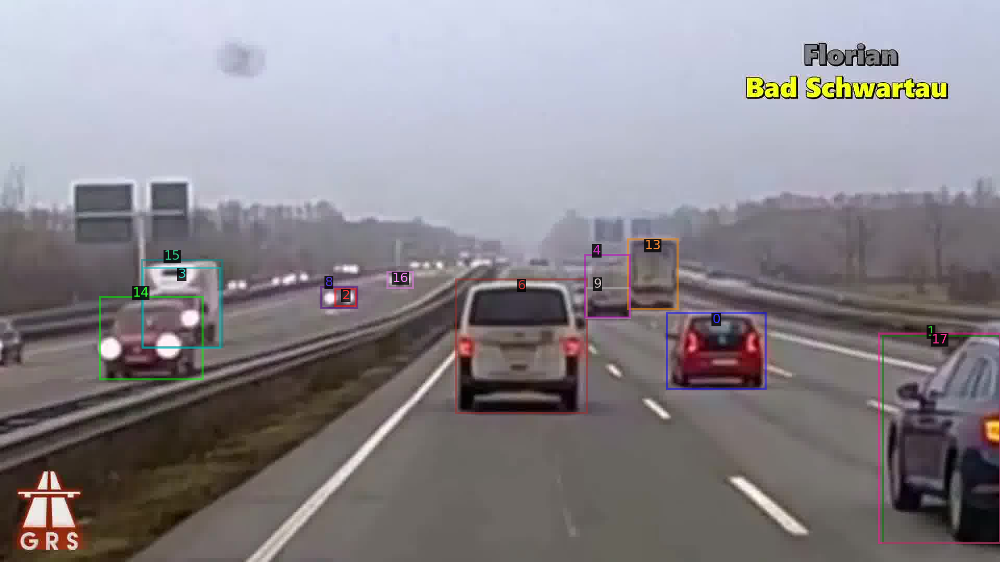

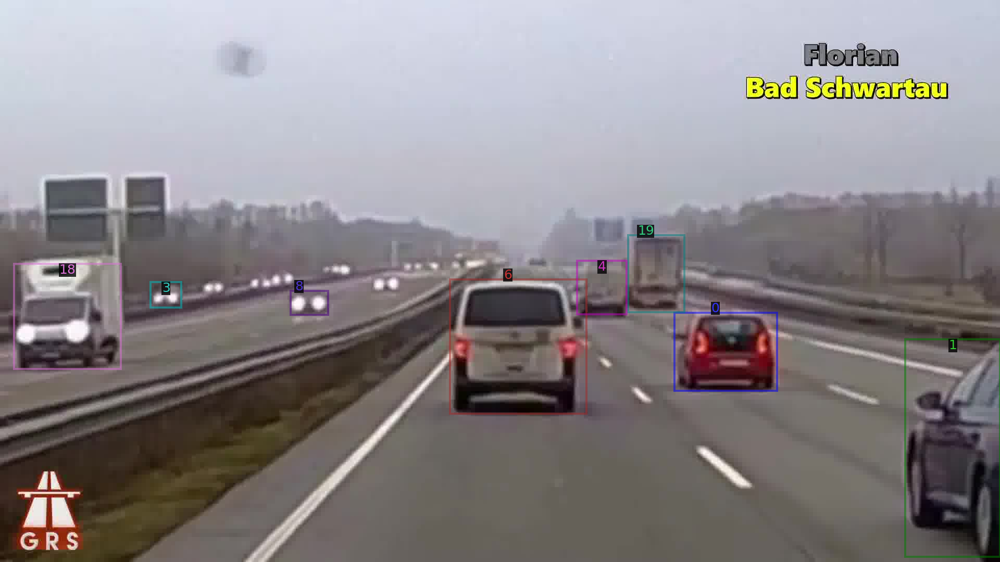

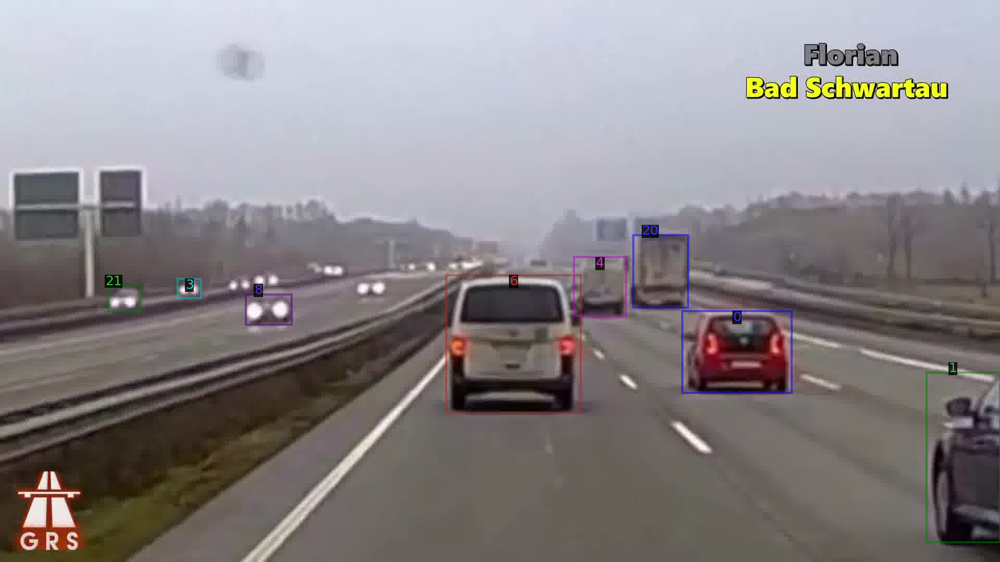

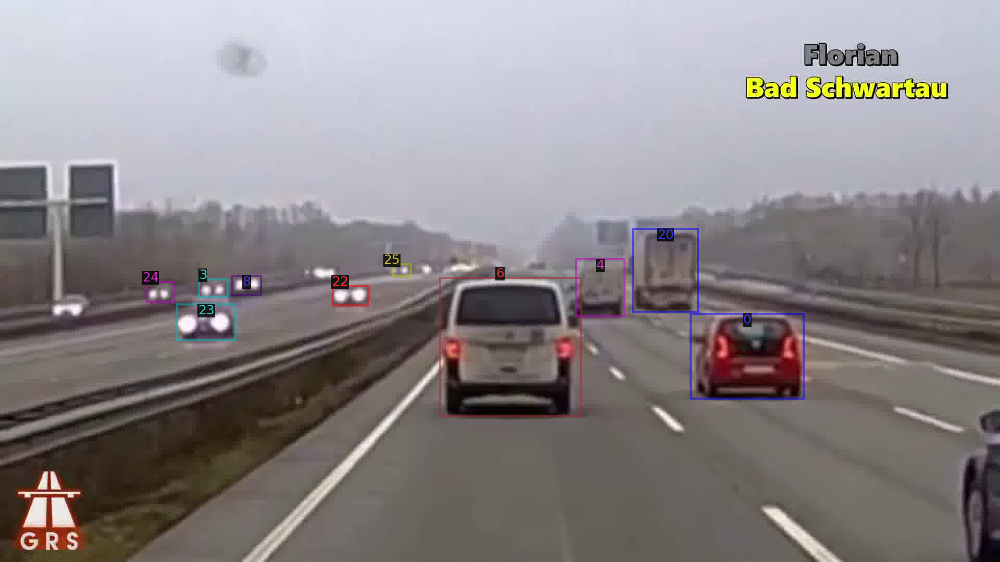

...

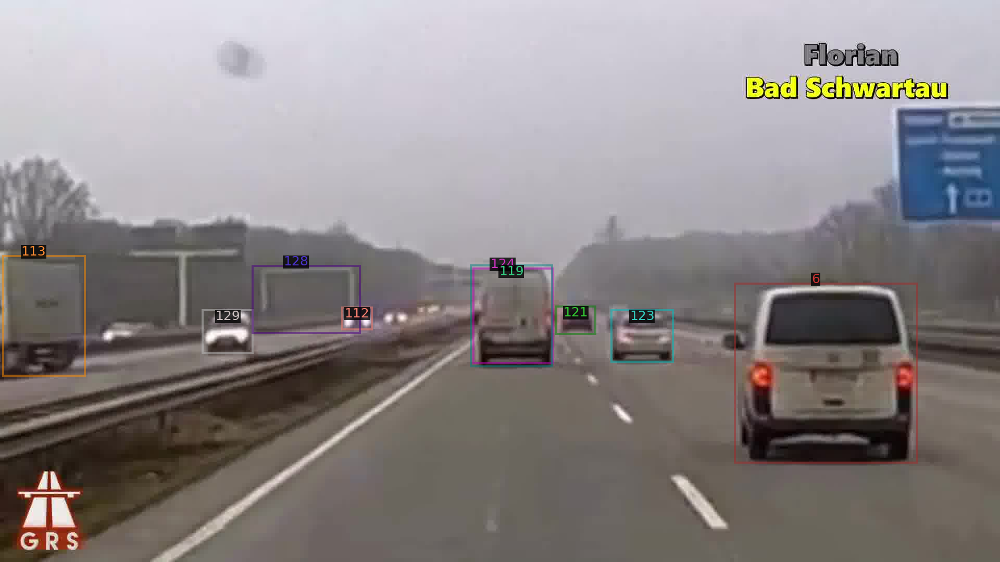

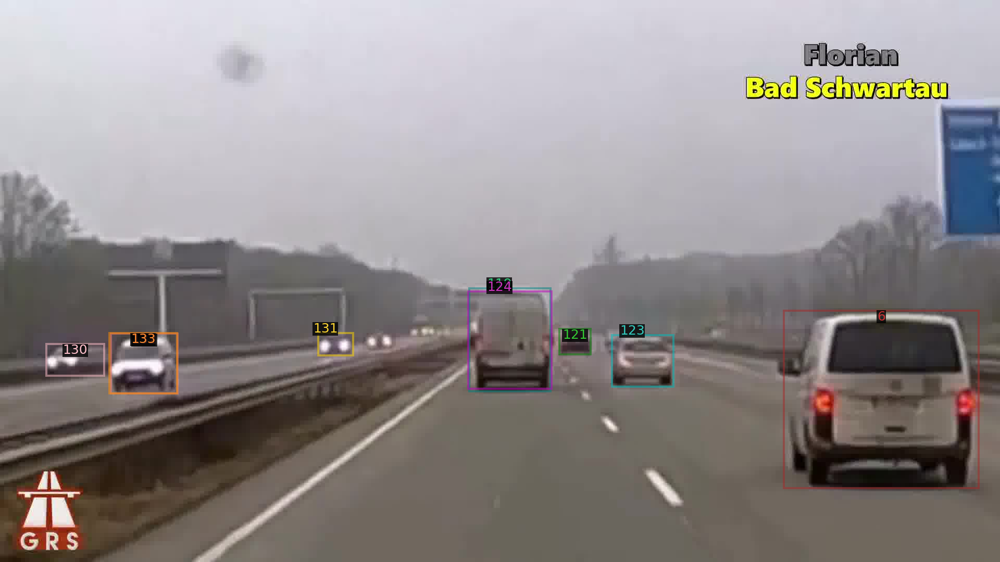

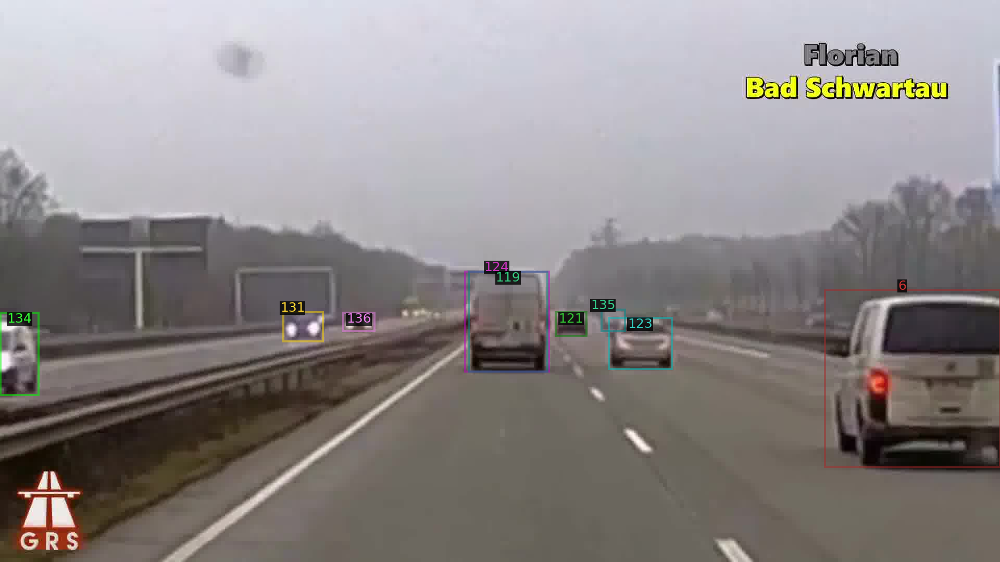

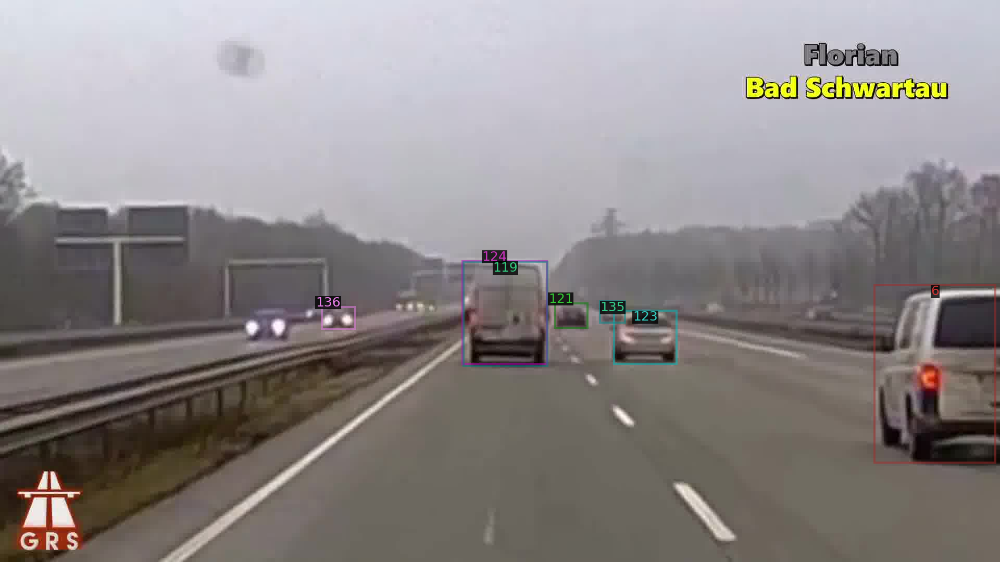

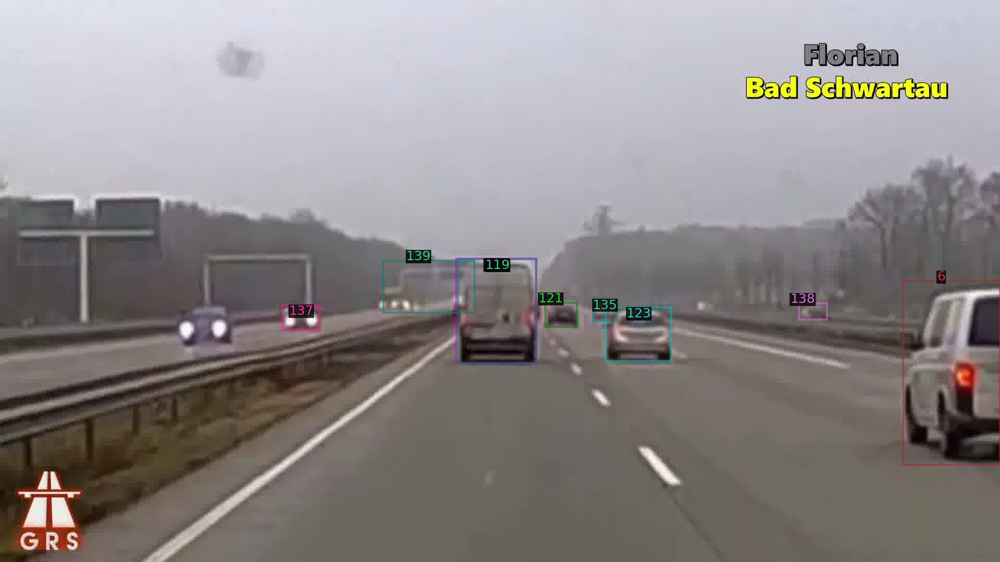

In [ ]:
with_iou=True   #Change it here if you don't want to use iou in matching score, if False it will use category based linking
assignment_maching_score= True # True to Use linear sum assignment for caluculating the best match else argmax will be used
dt=41 # change the horizon here (for how many frames it track)

assert dt<=len(predictions), "The horizon should be less than the number of frames you have"
map_current ={}
map_prev ={}
global_id=0
for i in range(dt):
  im = cv2.imread(directory+frames[i])
  outputs = predictor(im)
  pred=predictions[i].pred_classes
  boxes=predictions[i].pred_boxes.tensor.cpu().numpy()
  matched_index=None
  v= Visualizer(im[:, :, ::-1])
  object_count=len(predictions[i])
  
  map_current={}
  for j in range(object_count):
    offset =(j*20)%40 # to shift the labels on the box by some value so that it could be easier to see overlapping box labels
    if map_prev: # check if this is no the first frame which has no previous
      matched_index=match_score(j, i-1, i, with_iou,assignment_maching_score) 
 
    if matched_index!=None:
      retrieved_index=map_prev[matched_index]
      # print("The match for {} is ->->----->{} previously it was {}".format(j,x, to_put))
      map_current[j]=retrieved_index
      color=colors[retrieved_index%20]
      label = str(int(retrieved_index))
    else:
      # print("match for {} is not found it's assigned to be {}".format(j, count))
      color= colors[global_id%20]
      label= str(global_id)
      map_current[j]=global_id
      global_id+=1
    box_coord=boxes[j]
    out= v.draw_box(box_coord, alpha=0.5, edge_color=color, line_style='-')
    out=v.draw_text(label, (((box_coord[0]+box_coord[2])/2)-offset,box_coord[1]-offset), font_size=25, color=color)
  map_prev=map_current
  img=out.get_image()[:, :, ::-1]
  cv2_imshow(img)
  # cv2.imwrite('./report/ttvideo'+str(i)+'.jpg', img)
